<a href="https://colab.research.google.com/github/mariaalabdulrahman/GenAI_Workshop/blob/main/DM_FossilNET.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Simple Diffusion Model Tutorial

- Forward mode: destroying image/input $X_0$ by gradually adding noise until timestep point $X_t$
- Backward mode: recovering or denoising from $X_t$ image noice to back to $X_0$


## FossilNET dataset


In [ ]:
#upload dataloader file
from google.colab import files
src = list(files.upload().values())[0]
open('dataloader_fossilnet.py','wb').write(src)

Saving dataloader_fossilnet.py to dataloader_fossilnet (2).py


3570

## Data Visualization

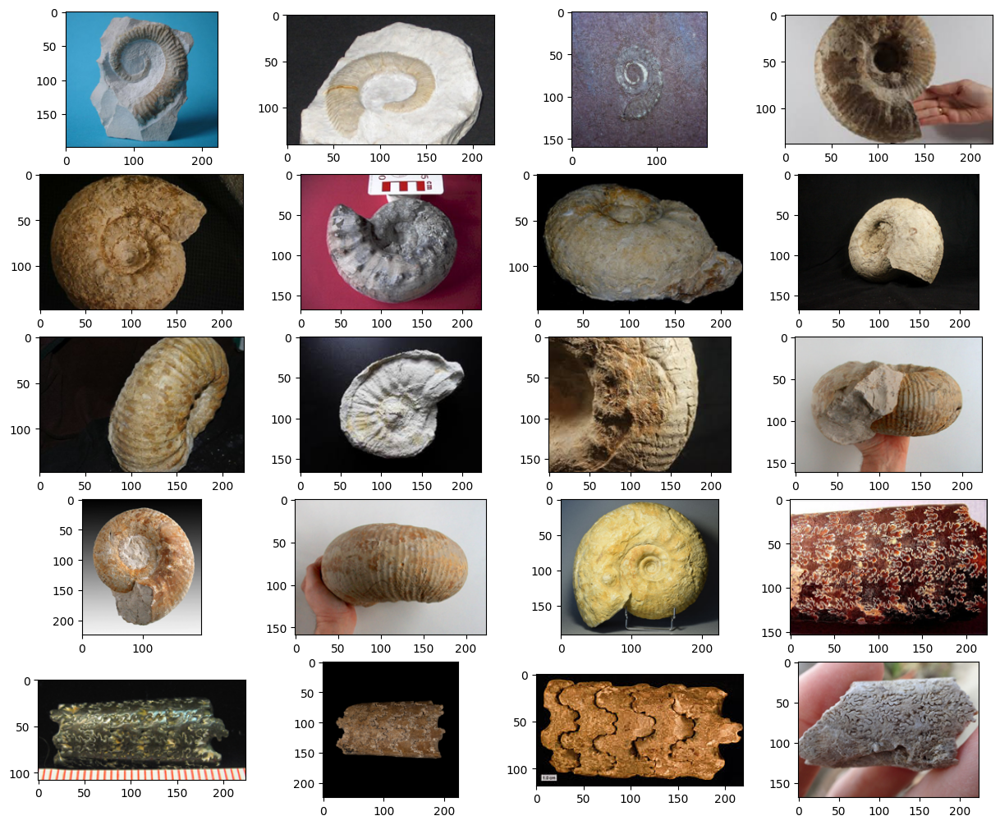

In [ ]:
import torch
import torchvision
import matplotlib.pyplot as plt
from dataloader_fossilnet import FossilNET

def show_images(datset, num_samples=20, cols=4):
    """ Plots some samples from the dataset """
    plt.figure(figsize=(15,15))
    for i, img in enumerate(training_data):
        if i == num_samples:
            break
        plt.subplot(int(num_samples/cols) + 1, cols, i + 1)
        plt.imshow(img[0])

# data = torchvision.datasets.StanfordCars(root=".", download=True)

training_data = FossilNET('dataset', 'train', download=True)
show_images(training_data)

# Building the Simple Diffusion Model
- Step 1: The forward process ==> Noise scheduler
- Step 2: Parameterized backward process ==> NN Model[U-Net (autoencoder)](https://amaarora.github.io/2020/09/13/unet.html)
- step 3: Positional Encoding ==> [timestep encoding](colab.research.google.com/drive/1niCAKS1dJ74_De8Nk_V3_Rx2tpNLadYD#scrollTo=dc8120e5)

## Pre-calculate the noisy version of an image for a specific time step $t$

We can pre-calculate closed form of the mean and variance based on cumulative variance

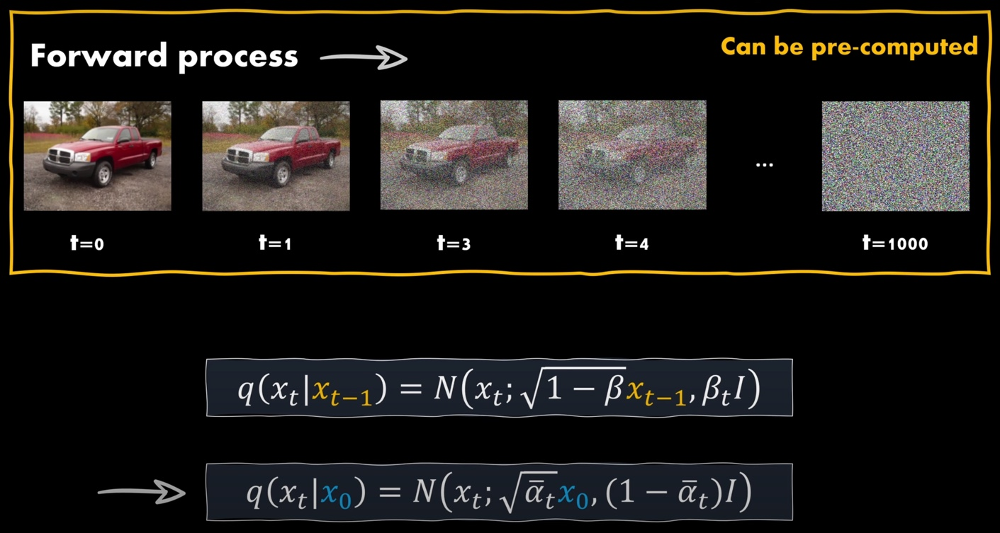


# Lets take an example for better understanding :)

let's say we choose 200 time steps, $t$ =200, im our diffusion process, and the variance schedule beta contains [$\beta_0$, $\beta_1$,$\beta_2$,...,$\beta_t$], e.g: [ 0.0001, 0.0002, ..., 0.02], whcich tells us how much noicse we want to add in each of the steps.

We linearly increase it until a maximum value of 0.02

$$q(\mathbf{x}_t | \mathbf{x}_0) = N(\mathbf{x}_t; \sqrt{\bar{\alpha}_t} \mathbf{x}_0, (1- \bar{\alpha}_t) \mathbf{I})$$

- ${\alpha}$ is 1-${\beta}$, which is a number that tells us how much information of the original image we keepwhen transitioning from one image to the next.
- $\bar{\alpha}$ is the cumulative product of these $\alpha$ terms, we get a new distribution  that allows us to sample for a specific time step.




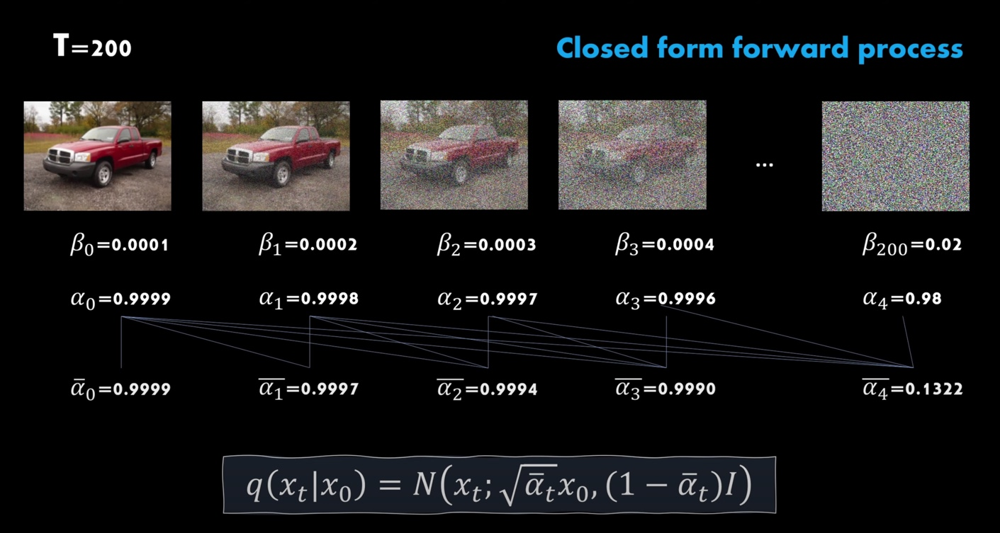


In [ ]:
import torch.nn.functional as F

# beta_0=0.0001, beta_200=0.02 beta 0 to beta t
#timestep(T)=200
#alpha_0=> 1-beta=0.9999

def linear_beta_schedule(timesteps, start=0.0001, end=0.02):
    """
    Returns a beta_schedule for betas.
    """
    return torch.linspace(start, end, timesteps)
# a helper function to extract a specific index from a list
def get_index_from_list(vals, t, x_shape):
    """
    Returns a specific index t of a passed list of values vals
    while considering the batch dimension.
    """
    batch_size = t.shape[0]
    out = vals.gather(-1, t.cpu())
    return out.reshape(batch_size, *((1,) * (len(x_shape) - 1))).to(t.device)


# Code: pre-calculate the noisy version of an image for a specific time step $t$

$$q(\mathbf{x}_t | \mathbf{x}_0) = \cal{N}(\mathbf{x}_t; \sqrt{\bar{\alpha}_t} \mathbf{x}_0, (1- \bar{\alpha}_t) \mathbf{I})$$

In [ ]:
# Define beta schedule
T = 300
betas = linear_beta_schedule(timesteps=T)

# Pre-calculate different terms for closed form
alphas = 1. - betas
alphas_cumprod = torch.cumprod(alphas, axis=0)
alphas_cumprod_prev = F.pad(alphas_cumprod[:-1], (1, 0), value=1.0)
sqrt_recip_alphas = torch.sqrt(1.0 / alphas)
sqrt_alphas_cumprod = torch.sqrt(alphas_cumprod)
sqrt_one_minus_alphas_cumprod = torch.sqrt(1. - alphas_cumprod)
posterior_variance = betas * (1. - alphas_cumprod_prev) / (1. - alphas_cumprod)

## Step 1: The forward process = Noise scheduler
In this step a markove process is usually denoted by $q$, and the noise that is added to ann image depends only on the previous image.

$$
q(\mathbf{x}_t | \mathbf{x}_{t-1}) = \mathcal{N}(\mathbf{x}_t; \sqrt{1 - \beta_t} \mathbf{x}_{t-1}, \beta_t \mathbf{I}).
$$

- $\mathbf{x}_{0}$ is the initial inputs
- $\mathbf{x}_{t-1}$ is noisy versions of $\mathbf{x}_{0}$
- variance schedule is the sequence of Betas that describes how much noice we want to add in each of the time steps (t)
- $\mathbf{x}_{t-1}$ is the previous image which means the mean of our distribution is exactly the previous image $\mathbf{x}_{t-1}$ multiplied with $\sqrt{1 - \beta_t}$ that depends on the variance schedule $\beta$
- $\beta_t.\mathbf{I}$  is the variance of the normal distribution that fixed to $\beta$ multiplied with identity by $\mathbf{I}$



The noise is sappled by applying a conditional Gaussian definition with a mean that depends on the previous image and specific variance
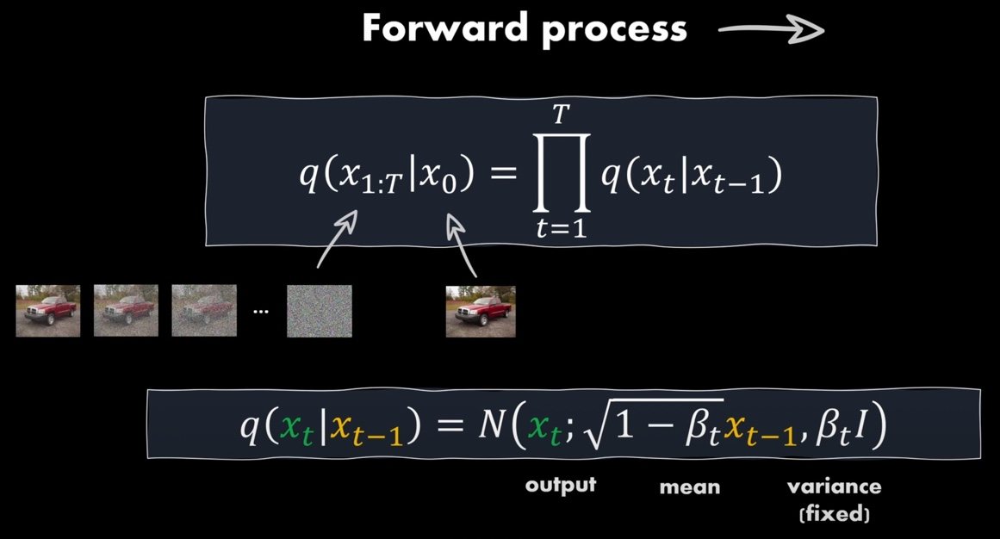





We first need to build the inputs for our model, which are more and more noisy images. Instead of doing this sequentially, we can use the closed form provided in the papers to calculate the image for any of the timesteps individually.

**Key Takeaways**:
- The noise-levels/variances can be pre-computed
- There are different types of variance schedules
- We can sample each timestep image independently (Sums of Gaussians is also Gaussian)
- No model is needed in this forward step

In [ ]:

# main function
# Forward function that usesd some pre-calculated values from here :
def forward_diffusion_sample(x_0, t, device="cpu"):
    """
    Takes an image and a timestep as input and
    returns the noisy version of it
    """
    noise = torch.randn_like(x_0) # sampling some noise
    sqrt_alphas_cumprod_t = get_index_from_list(sqrt_alphas_cumprod, t, x_0.shape)
    sqrt_one_minus_alphas_cumprod_t = get_index_from_list(
        sqrt_one_minus_alphas_cumprod, t, x_0.shape
    )
    # mean + variance
    return sqrt_alphas_cumprod_t.to(device) * x_0.to(device) \
    + sqrt_one_minus_alphas_cumprod_t.to(device) * noise.to(device), noise.to(device)



## Test forward function on the dataset

In [ ]:
from torchvision import transforms
from torch.utils.data import DataLoader
import numpy as np

IMG_SIZE = 64
BATCH_SIZE = 128


def load_dataset():

  reverse_transforms = transforms.Compose([
            transforms.Resize((IMG_SIZE, IMG_SIZE)),
            transforms.RandomHorizontalFlip(),
            transforms.ToTensor(),
            transforms.Lambda(lambda t: (t * 2) - 1) # Scale between [-1, 1]
    ])

  train = FossilNET('dataset', 'train', transform=reverse_transforms, download=True)

  test = FossilNET('dataset', 'test', transform=reverse_transforms, download=True)

  return torch.utils.data.ConcatDataset([train, test])

def show_tensor_image(image):
    reverse_transforms = transforms.Compose([
        transforms.Lambda(lambda t: (t + 1) / 2),
        transforms.Lambda(lambda t: t.permute(1, 2, 0)), # CHW to HWC
        transforms.Lambda(lambda t: t * 255.),
        transforms.Lambda(lambda t: t.numpy().astype(np.uint8)),
        transforms.ToPILImage(),
    ])

    # Take first image of batch
    if len(image.shape) == 4:
        image = image[0, :, :, :]
    plt.imshow(reverse_transforms(image))

data = load_dataset()
# Initializing pytorch dataloader
dataloader = DataLoader(data, batch_size=BATCH_SIZE, shuffle=True, drop_last=True)

<ipython-input-31-f4853fe96c6f>:11: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1, num_images+1, int(idx/stepsize) + 1)


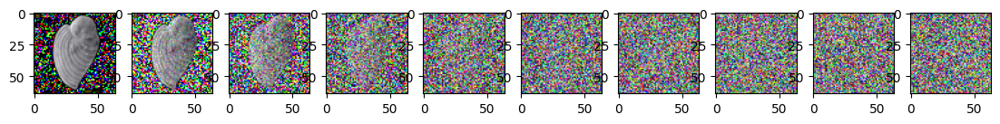

In [ ]:
# Simulate forward diffusion
image = next(iter(dataloader))[0]

plt.figure(figsize=(15,15))
plt.axis('off')
num_images = 10
stepsize = int(T/num_images)

for idx in range(0, T, stepsize):
    t = torch.Tensor([idx]).type(torch.int64)
    plt.subplot(1, num_images+1, int(idx/stepsize) + 1)
    img, noise = forward_diffusion_sample(image, t)
    show_tensor_image(img)

## Step 2: The backward process = NN model based on U-Net architecture  
U-Net architecture is a special NN that has structer used in auto encoder(Autoencoder) that useful for image segmentation.
- Downsampling layers
- Upsampling layers

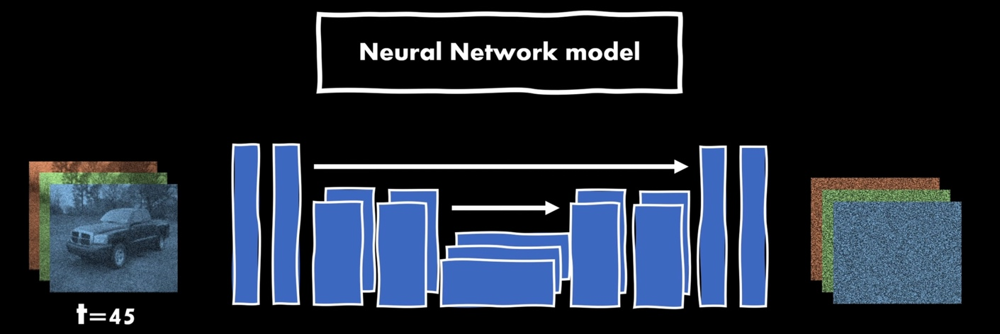


# Step 2: Parametrized backward process

Mathematically, we start with the following formula:

$$
q(\mathbf{x}_{t}) = \mathcal{N}(\mathbf{x}_t;0, \mathbf{I})$$

Then in the sequence the transition from one latent to the next is predicted. This makes the model learn the probability density of an earlier time step given the current time step.

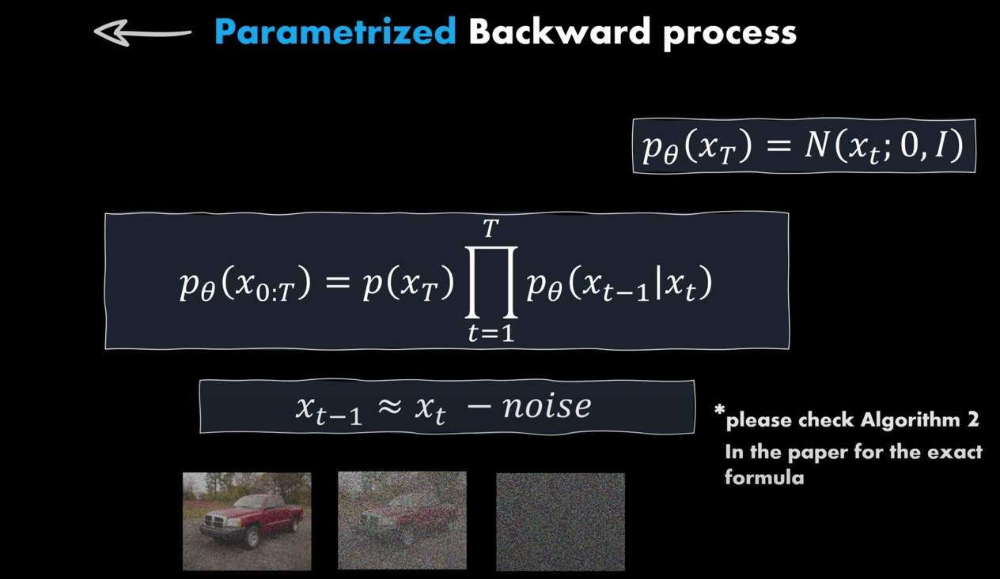

For a great introduction to UNets, have a look at this post: https://amaarora.github.io/2020/09/13/unet.html.


**Key Takeaways**:
- We use a simple form of a UNet for to predict the noise in the image
- The input is a noisy image, the ouput the noise in the image
- Because the parameters are shared accross time, we need to tell the network in which timestep we are
- The Timestep is encoded by the transformer Sinusoidal Embedding
- We output one single value (mean), because the variance is fixed


In [ ]:
from torch import nn
import math


class Block(nn.Module):
    def __init__(self, in_ch, out_ch, time_emb_dim, up=False):
        super().__init__()
        self.time_mlp =  nn.Linear(time_emb_dim, out_ch)
        if up:
            self.conv1 = nn.Conv2d(2*in_ch, out_ch, 3, padding=1)
            self.transform = nn.ConvTranspose2d(out_ch, out_ch, 4, 2, 1)
        else:
            self.conv1 = nn.Conv2d(in_ch, out_ch, 3, padding=1)
            self.transform = nn.Conv2d(out_ch, out_ch, 4, 2, 1)
        self.conv2 = nn.Conv2d(out_ch, out_ch, 3, padding=1)
        self.bnorm1 = nn.BatchNorm2d(out_ch)
        self.bnorm2 = nn.BatchNorm2d(out_ch)
        self.relu  = nn.ReLU()

    def forward(self, x, t, ):
        # First Conv
        h = self.bnorm1(self.relu(self.conv1(x)))
        # Time embedding
        time_emb = self.relu(self.time_mlp(t))
        # Extend last 2 dimensions
        #The resulting tensor has shape(Timestep, Batch Size, 1, 1, Embedding Size)
        time_emb = time_emb[(..., ) + (None, ) * 2]
        # Add time channel
        h = h + time_emb
        # Second Conv
        h = self.bnorm2(self.relu(self.conv2(h)))
        # Down or Upsample
        return self.transform(h)


class SimpleUnet(nn.Module):
    """
    A simplified variant of the Unet architecture.
    """
    def __init__(self):
        super().__init__()
        image_channels = 3
        down_channels = (64, 128, 256, 512, 1024)
        up_channels = (1024, 512, 256, 128, 64)
        out_dim = 3
        time_emb_dim = 32

        # Time embedding
        self.time_mlp = nn.Sequential(
                SinusoidalPositionEmbeddings(time_emb_dim),
                nn.Linear(time_emb_dim, time_emb_dim),
                nn.ReLU()
            )

        # Initial projection
        self.conv0 = nn.Conv2d(image_channels, down_channels[0], 3, padding=1)

        # Downsample
        self.downs = nn.ModuleList([Block(down_channels[i], down_channels[i+1], \
                                    time_emb_dim) \
                    for i in range(len(down_channels)-1)])
        # Upsample
        self.ups = nn.ModuleList([Block(up_channels[i], up_channels[i+1], \
                                        time_emb_dim, up=True) \
                    for i in range(len(up_channels)-1)])

        # Edit: Corrected a bug found by Jakub C (see YouTube comment)
        self.output = nn.Conv2d(up_channels[-1], out_dim, 1)

    def forward(self, x, timestep):
        # Embedd time
        t = self.time_mlp(timestep)
        # Initial conv
        x = self.conv0(x)
        # Unet
        residual_inputs = []
        for down in self.downs:
            x = down(x, t)
            residual_inputs.append(x)
        for up in self.ups:
            residual_x = residual_inputs.pop()
            # Add residual x as additional channels
            x = torch.cat((x, residual_x), dim=1)
            x = up(x, t)
        return self.output(x)

model = SimpleUnet()
print("Num params: ", sum(p.numel() for p in model.parameters()))
model

Num params:  62438883


SimpleUnet(
  (time_mlp): Sequential(
    (0): SinusoidalPositionEmbeddings()
    (1): Linear(in_features=32, out_features=32, bias=True)
    (2): ReLU()
  )
  (conv0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (downs): ModuleList(
    (0): Block(
      (time_mlp): Linear(in_features=32, out_features=128, bias=True)
      (conv1): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (transform): Conv2d(128, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bnorm1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (bnorm2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU()
    )
    (1): Block(
      (time_mlp): Linear(in_features=32, out_features=256, bias=True)
      (conv1): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (transfor

In [ ]:
@torch.no_grad()
def backward(x, t):
    """
    Calls the model to predict the noise in the image and returns
    the denoised image.
    Applies noise to this image, if we are not in the last step yet.
    """
    betas_t = get_index_from_list(betas, t, x.shape)
    sqrt_one_minus_alphas_cumprod_t = get_index_from_list(
        sqrt_one_minus_alphas_cumprod, t, x.shape
    )
    sqrt_recip_alphas_t = get_index_from_list(sqrt_recip_alphas, t, x.shape)

    # Call model (current image - noise prediction)
    model_mean = sqrt_recip_alphas_t * (
        x - betas_t * model(x, t) / sqrt_one_minus_alphas_cumprod_t
    )
    posterior_variance_t = get_index_from_list(posterior_variance, t, x.shape)

    if t == 0:
        # As pointed out by Luis Pereira (see YouTube comment)
        # The t's are offset from the t's in the paper
        return model_mean
    else:
        noise = torch.randn_like(x)
        return model_mean + torch.sqrt(posterior_variance_t) * noise


# Step 3: Timestep encoding
Considering the time step in our model, the NN has shared parameters across time, which means it can't distinguish btween the different time steps :(
Thus, the model needs to filter out the noise from images with very different noise intensities by using positional embeddings which are presented in the transformer model.

### Simple methods to encode discrete positional information
- Sin functions
- Cosin functions

The next figure is a visualized positional embedding .
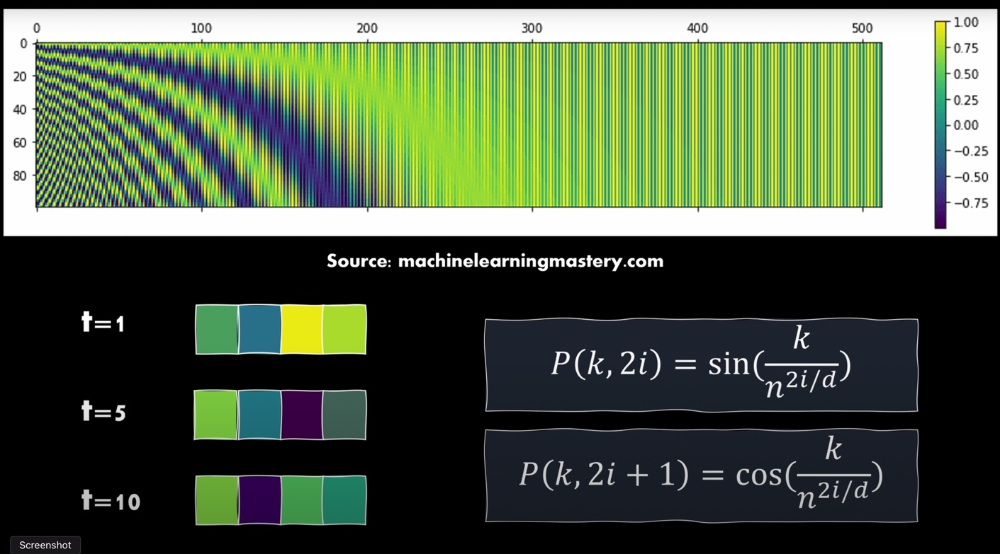

In [ ]:
class SinusoidalPositionEmbeddings(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.dim = dim

    def forward(self, time):
        device = time.device
        half_dim = self.dim // 2
        embeddings = math.log(10000) / (half_dim - 1)
        embeddings = torch.exp(torch.arange(half_dim, device=device) * -embeddings)
        embeddings = time[:, None] * embeddings[None, :]
        embeddings = torch.cat((embeddings.sin(), embeddings.cos()), dim=-1)
        return embeddings


## Sampling Algorithm
In order to get the actual image of time step $X_t-1$, we have to substract the predicted noise from the image $X_t$ during sampling.

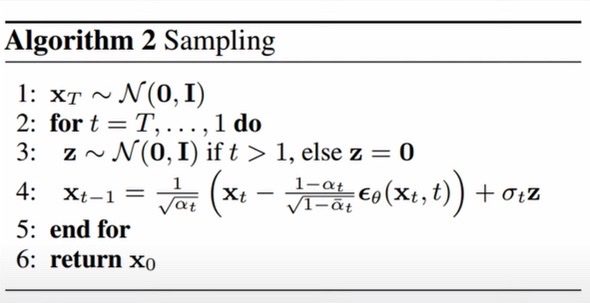
- Without adding @torch.no_grad() we quickly run out of memory, because pytorch tacks all the previous images for gradient calculation
- Because we pre-calculated the noise variances for the forward pass, we also have to use them when we sequentially perform the backward process

In [ ]:
@torch.no_grad()
def sample_plot_image():
    # Sample noise
    img_size = IMG_SIZE
    img = torch.randn((1, 3, img_size, img_size), device=device)
    plt.figure(figsize=(15,15))
    plt.axis('off')
    num_images = 10
    stepsize = int(T/num_images)

    for i in range(0,T)[::-1]:
        t = torch.full((1,), i, device=device, dtype=torch.long)
        img = backward(img, t)
        # Edit: This is to maintain the natural range of the distribution
        img = torch.clamp(img, -1.0, 1.0)
        if i % stepsize == 0:
            plt.subplot(1, num_images, int(i/stepsize)+1)
            show_tensor_image(img.detach().cpu())
    plt.show()


## loss calculation
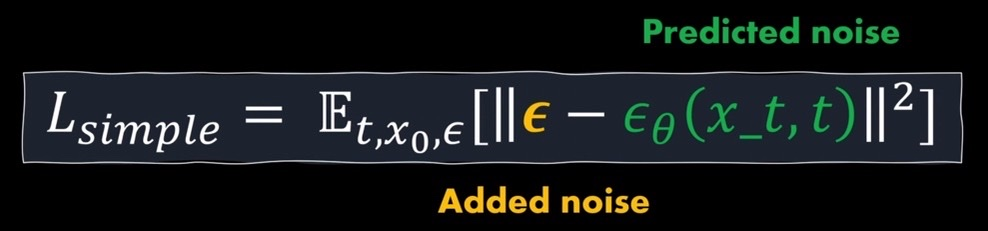


**Key Takeaways:**
- After some maths we end up with a very simple loss function
- There are other possible choices like L2 loss etc.


In [ ]:
def get_loss(model, x_0, t):
    x_noisy, noise = forward_diffusion_sample(x_0, t, device)
    noise_pred = model(x_noisy, t)
    return F.l1_loss(noise, noise_pred)

## Training

During the training, we just randomly sample time steps and don't go through the whole sequence at sampling time. However, we need to iterate from pure noise in $X_t$ to $X_0$, which is the final image.

Epoch 0 | step 000 Loss: 0.8125216960906982 


<ipython-input-35-6a54aa5fe44d>:17: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(1, num_images, int(i/stepsize)+1)


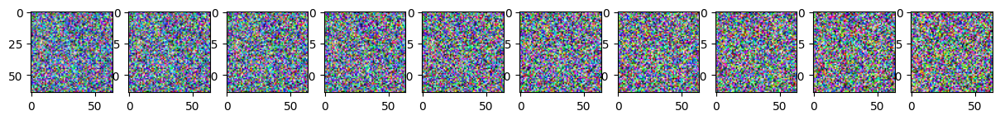

Epoch 5 | step 000 Loss: 0.23570369184017181 


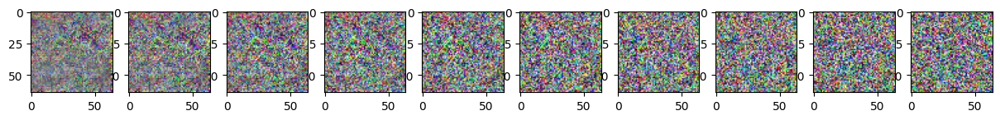

Epoch 10 | step 000 Loss: 0.2099459171295166 


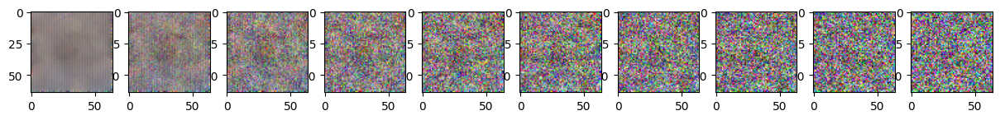

Epoch 15 | step 000 Loss: 0.18261420726776123 


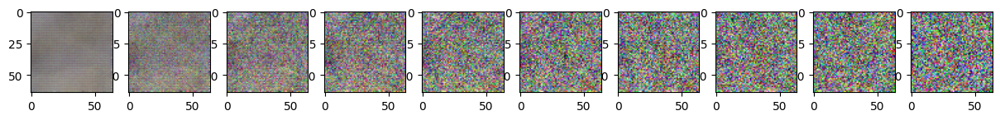

Epoch 20 | step 000 Loss: 0.1616339534521103 


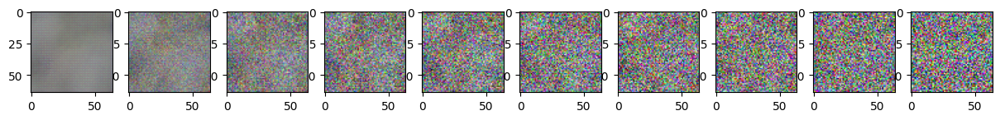

Epoch 25 | step 000 Loss: 0.14896629750728607 


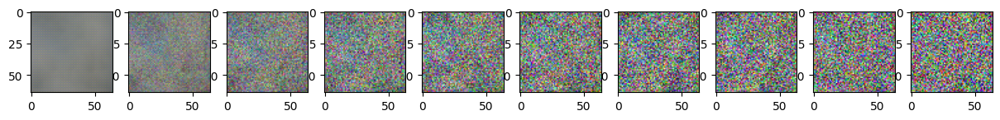

Epoch 30 | step 000 Loss: 0.15461914241313934 


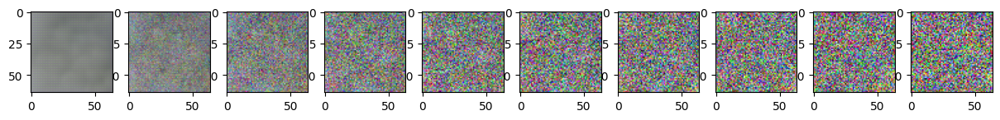

Epoch 35 | step 000 Loss: 0.14346477389335632 


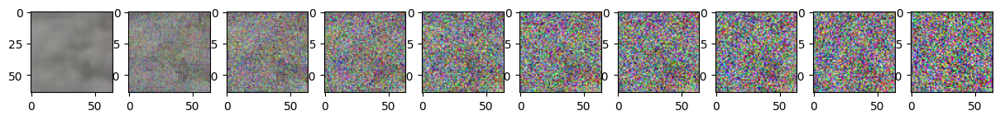

Epoch 40 | step 000 Loss: 0.15620361268520355 


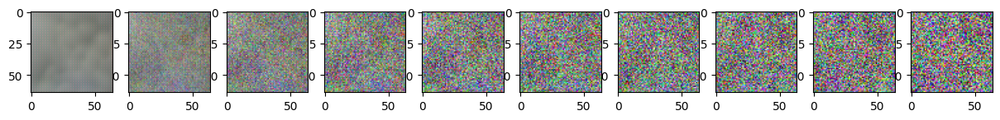

Epoch 45 | step 000 Loss: 0.15177258849143982 


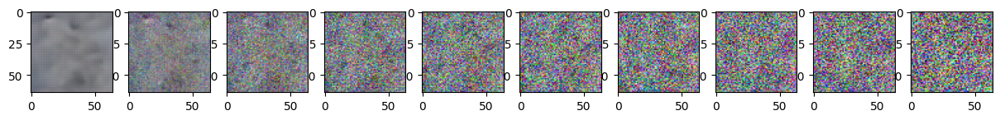

Epoch 50 | step 000 Loss: 0.15920671820640564 


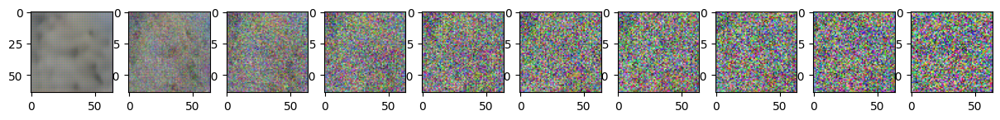

Epoch 55 | step 000 Loss: 0.1462489515542984 


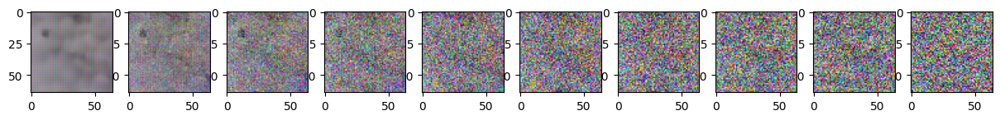

Epoch 60 | step 000 Loss: 0.16161836683750153 


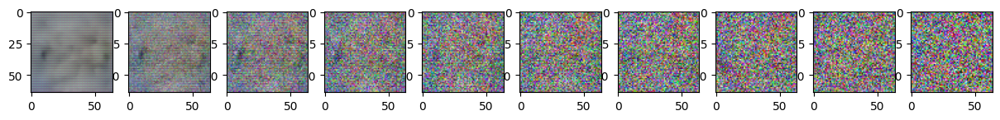

Epoch 65 | step 000 Loss: 0.13689422607421875 


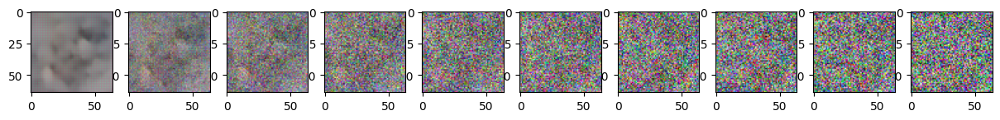

Epoch 70 | step 000 Loss: 0.1414109319448471 


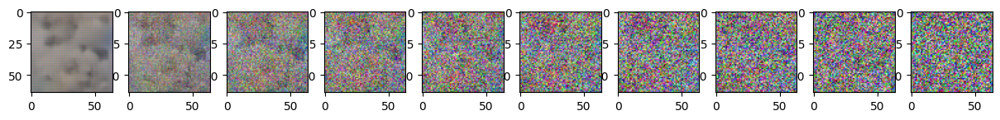

Epoch 75 | step 000 Loss: 0.1464693546295166 


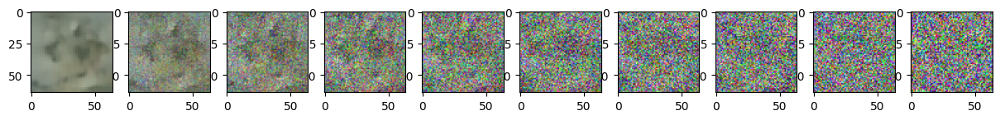

Epoch 80 | step 000 Loss: 0.13923290371894836 


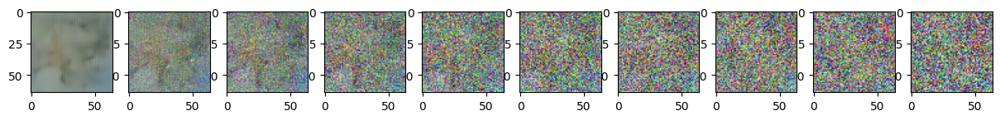

Epoch 85 | step 000 Loss: 0.1303449273109436 


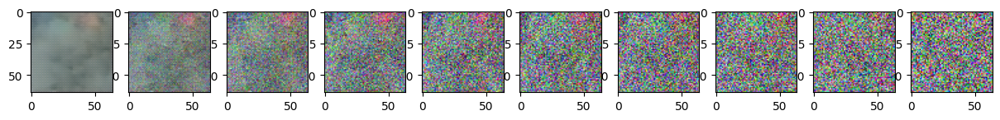

Epoch 90 | step 000 Loss: 0.13192595541477203 


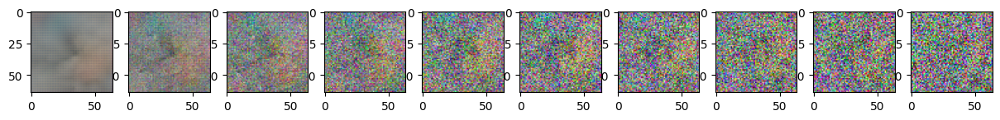

Epoch 95 | step 000 Loss: 0.1500558853149414 


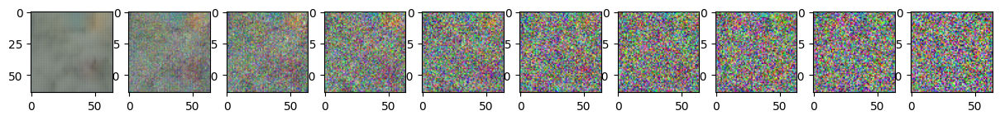

Epoch 100 | step 000 Loss: 0.13872522115707397 


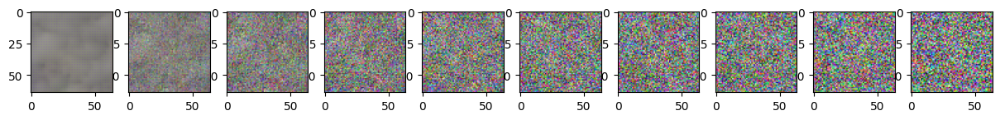

Epoch 105 | step 000 Loss: 0.14133408665657043 


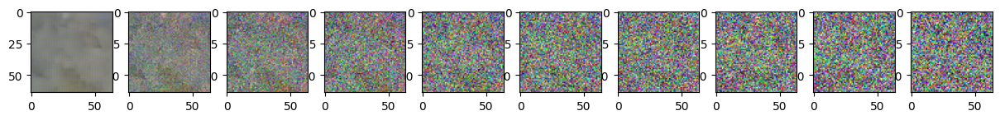

Epoch 110 | step 000 Loss: 0.1287641078233719 


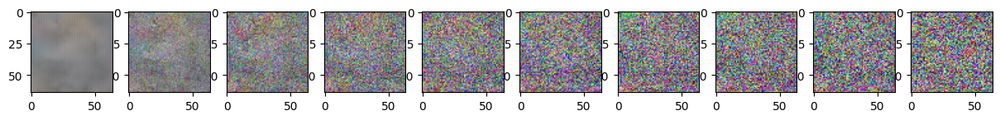

Epoch 115 | step 000 Loss: 0.13620230555534363 


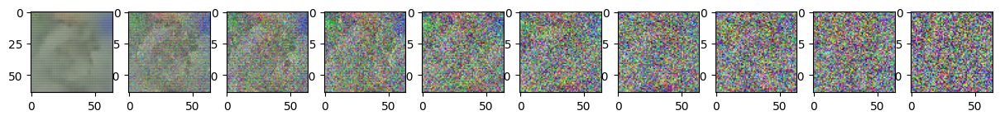

Epoch 120 | step 000 Loss: 0.12337882816791534 


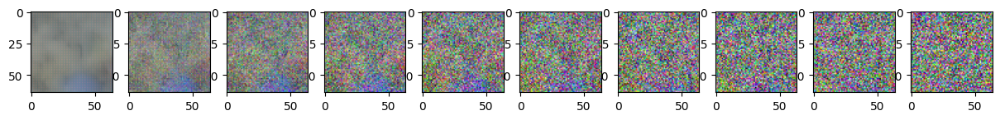

Epoch 125 | step 000 Loss: 0.13266915082931519 


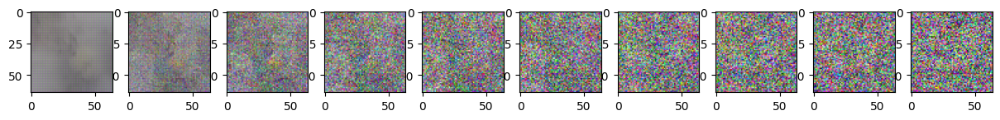

Epoch 130 | step 000 Loss: 0.12680286169052124 


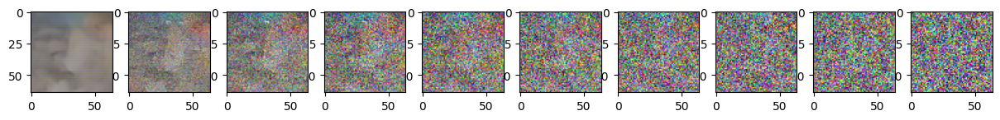

Epoch 135 | step 000 Loss: 0.11805865168571472 


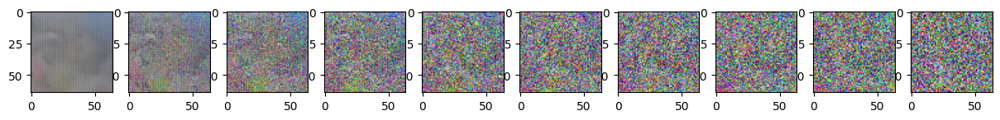

Epoch 140 | step 000 Loss: 0.13053053617477417 


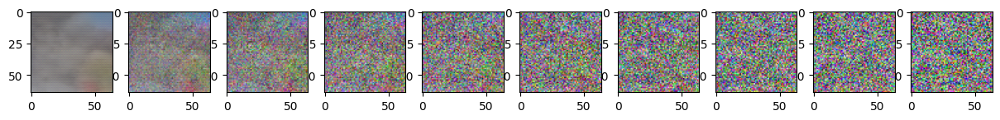

Epoch 145 | step 000 Loss: 0.1468554139137268 


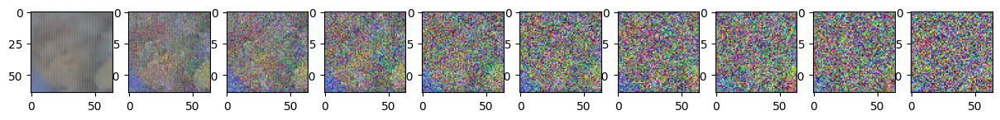

Epoch 150 | step 000 Loss: 0.12248484790325165 


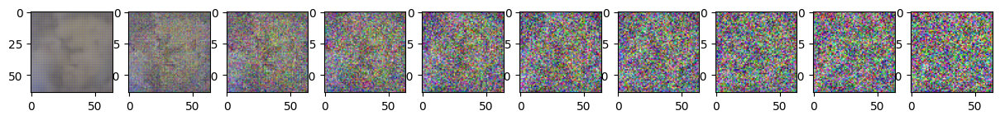

Epoch 155 | step 000 Loss: 0.15793472528457642 


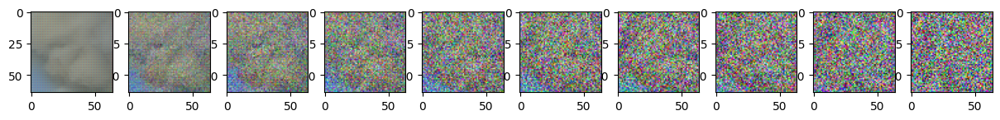

Epoch 160 | step 000 Loss: 0.11498765647411346 


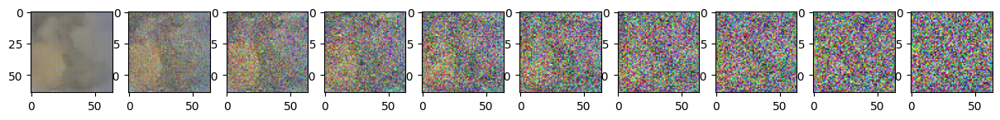

Epoch 165 | step 000 Loss: 0.12230618298053741 


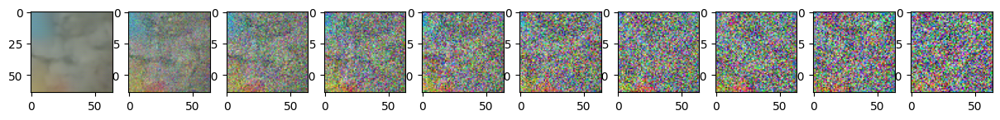

Epoch 170 | step 000 Loss: 0.1326235979795456 


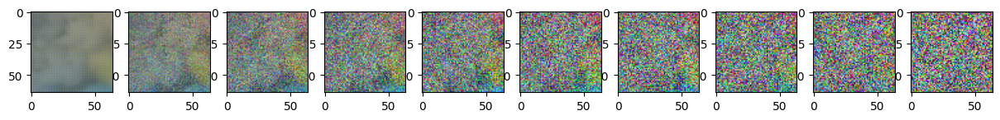

Epoch 175 | step 000 Loss: 0.13392305374145508 


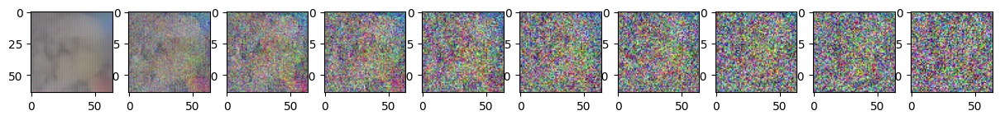

Epoch 180 | step 000 Loss: 0.12089147418737411 


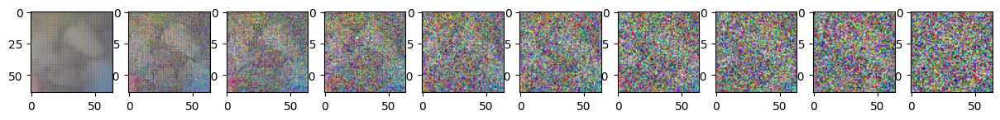

Epoch 185 | step 000 Loss: 0.11764281243085861 


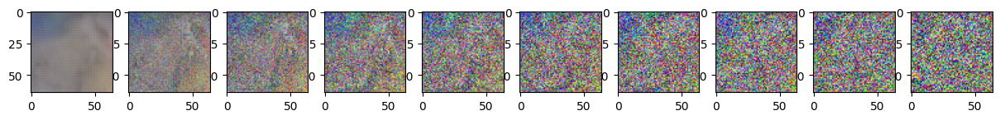

Epoch 190 | step 000 Loss: 0.12799468636512756 


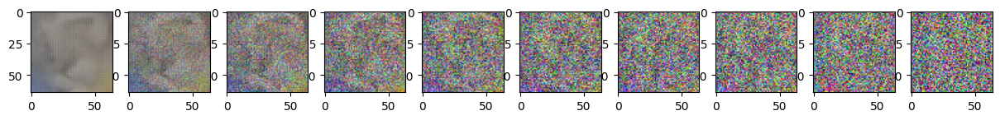

Epoch 195 | step 000 Loss: 0.1352238804101944 


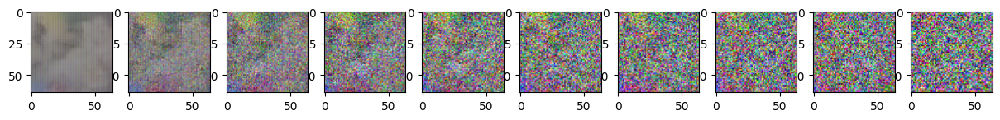

Epoch 200 | step 000 Loss: 0.1152600646018982 


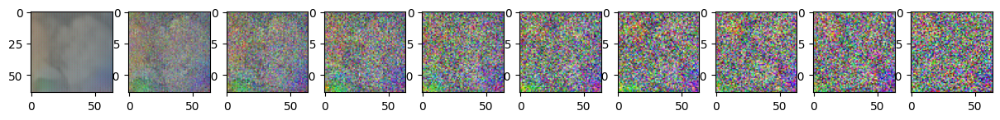

Epoch 205 | step 000 Loss: 0.12442834675312042 


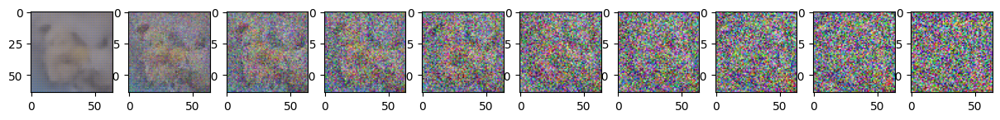

Epoch 210 | step 000 Loss: 0.12555468082427979 


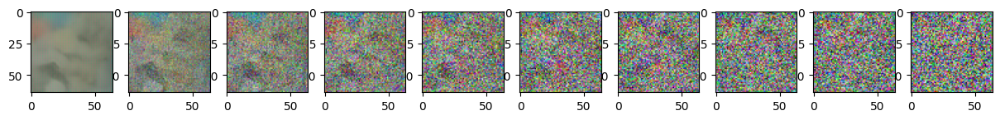

Epoch 215 | step 000 Loss: 0.11653278768062592 


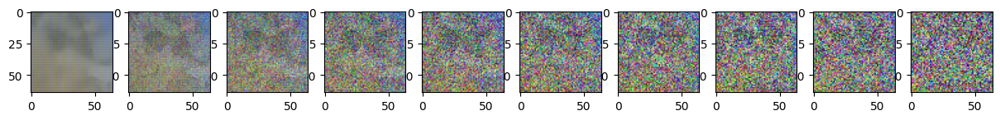

Epoch 220 | step 000 Loss: 0.12401558458805084 


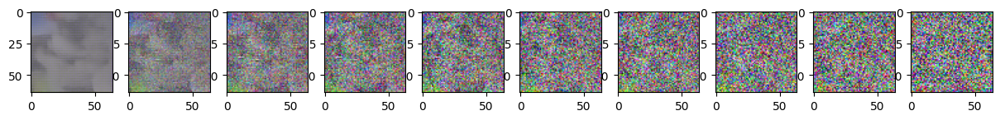

Epoch 225 | step 000 Loss: 0.12913674116134644 


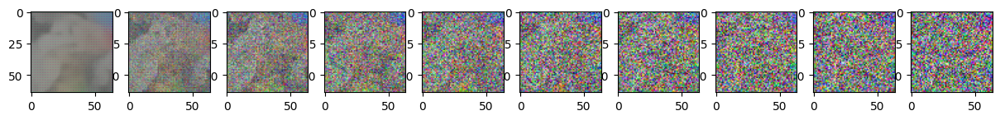

Epoch 230 | step 000 Loss: 0.12128859758377075 


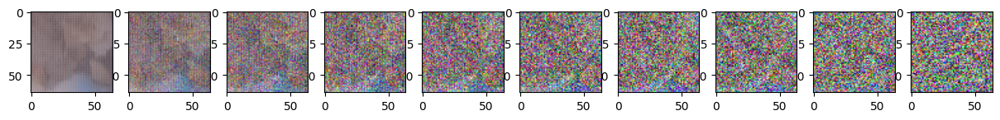

Epoch 235 | step 000 Loss: 0.11919939517974854 


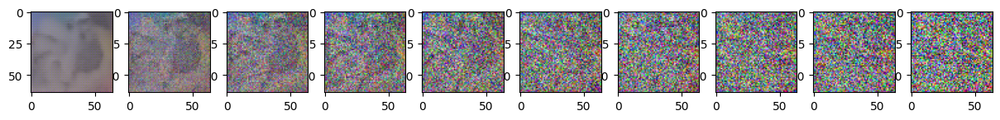

Epoch 240 | step 000 Loss: 0.12165659666061401 


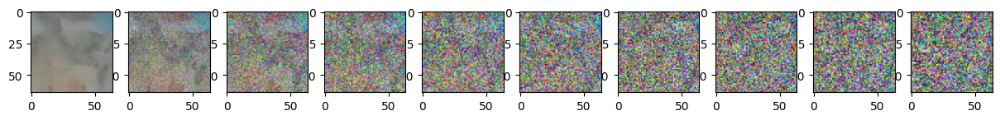

Epoch 245 | step 000 Loss: 0.13372668623924255 


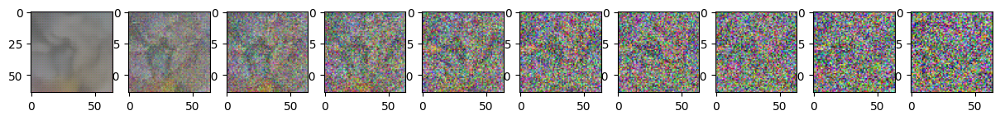

In [ ]:
from torch.optim import Adam

device = "cuda" if torch.cuda.is_available() else "cpu"
model.to(device)
optimizer = Adam(model.parameters(), lr=0.001)
epochs = 250 # Try more!

for epoch in range(epochs):
    for step, batch in enumerate(dataloader):
      optimizer.zero_grad()

      t = torch.randint(0, T, (BATCH_SIZE,), device=device).long()
      loss = get_loss(model, batch[0], t)
      loss.backward()
      optimizer.step()

      if epoch % 5 == 0 and step == 0:
        print(f"Epoch {epoch} | step {step:03d} Loss: {loss.item()} ")
        sample_plot_image()